# **Airbnb merupakan platform online untuk orang menyediakan atau menyewa tempat tinggal sementara. Airbnb kini tersedia di berbagai kota, Salah satunya adalah bangkok. Diketahui bahwa bangkok ibukota negara thailand yang menjadi pusat ekonomi,politik dan budaya.**

## **rumusan masalah**

- Pola sebaran dan lokasi properti?
- Dominasi type kamar?
- Populitas lokasi berdasarkan jumlah review?
- Minimum night?
- Sebaran Titik properti?

## **Tujuan**

- Mengidentifikasi lingkungan atau area yang menjadi pusat konsentrasi properti
- Menganalisis tipe kamar yang paling banyak di setiap kategori harga
- Mengidentifikasi lokasi paling populer berdasarkan jumlah ulasan
- Memahami kebijakan minimum stay yang diterapkan di setiap kategori harga
- Mengidentifikasi tren lokasi properti berdasarkan kategori harga

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import datetime

# **Dataset ini berisi data terkait Properti, Identifikasi, lokasi, profile pemilik, harga dan beberapa jenis kamar. Ada 17 kolom di dalam dataset Airbnb Listing Bangkok Berikut kolom-kolomnya:**


- id: Pengidentifikasi unik untuk setiap daftar.
- name: Nama ruangan atau judul ruangan
- host_id: Pengenal unik untuk tuan rumah/pengguna.
- host_name: Nama tuan rumah
- neighbourhood: Lingkungan tempat/Lokasi properti tersebut berada.
- latitude: Menggunakan proyeksi Sistem Geodesi Dunia (WGS84) untuk lintang dan bujur
- longitude: Menggunakan proyeksi Sistem Geodesi Dunia (WGS84) untuk lintang dan bujur
- room_type: Jenis kamar (Entire home/apt,Hotel room,Private room,Shared room).
- price: Harga yang tercantum per malam.
- minimum_nights: Jumlah malam minimum yang diperlukan untuk pemesanan.
- number_of_reviews: Jumlah total ulasan untuk properti tersebut.
- last_review: Tanggal review terakhir.
- reviews_per_month: Jumlah rata-rata ulasan per bulan.
- calculated_host_listings_count: Jumlah listing yang dikelola tuan rumah saat ini berdasarkan geografi kota/wilayah.
- availability_365: Ketersediaan properti selama 365 hari. Ini menunjukkan berapa banyak hari properti tersebut tersedia untuk disewa dalam satu tahun..
- number_of_reviews_ltm: Jumlah ulasan dalam 12 bulan terakhir.

In [2]:
df = pd.read_csv("Airbnb Listings Bangkok.csv")
display(df.head(),df.tail())

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
0,0,27934,Nice room with superb city view,120437,Nuttee,Ratchathewi,13.75983,100.54134,Entire home/apt,1905,3,65,2020-01-06,0.50,2,353,0
1,1,27979,"Easy going landlord,easy place",120541,Emy,Bang Na,13.66818,100.61674,Private room,1316,1,0,NaN,NaN,2,358,0
2,2,28745,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.75232,100.62402,Private room,800,60,0,NaN,NaN,1,365,0
3,3,35780,Spacious one bedroom at The Kris Condo Bldg. 3,153730,Sirilak,Din Daeng,13.78823,100.57256,Private room,1286,7,2,2022-04-01,0.03,1,323,1
4,4,941865,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.76872,100.63338,Private room,1905,1,0,NaN,NaN,3,365,0


,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm
15849,15849,790465040741092826,素坤逸核心两房公寓42楼，靠近BTSon nut/无边天际泳池观赏曼谷夜景/出门当地美食街,94899359,Renee,Pra Wet,13.715132,100.653458,Private room,2298,28,0,NaN,NaN,1,362,0
15850,15850,790474503157243541,Euro LuxuryHotel PratunamMKt TripleBdNrShoping...,491526222,Phakhamon,Ratchathewi,13.753052,100.538738,Private room,1429,1,0,NaN,NaN,14,365,0
15851,15851,790475335086864240,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.753169,100.538700,Private room,1214,1,0,NaN,NaN,14,365,0
15852,15852,790475546213717328,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.754789,100.538757,Private room,1214,1,0,NaN,NaN,14,365,0
15853,15853,790476492384199044,Euro LuxuryHotel PratunamMKt TwinBedNrShopingArea,491526222,Phakhamon,Ratchathewi,13.752960,100.540820,Private room,1214,1,0,NaN,NaN,14,365,0


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15854 entries, 0 to 15853
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Unnamed: 0                      15854 non-null  int64  
 1   id                              15854 non-null  int64  
 2   name                            15846 non-null  object 
 3   host_id                         15854 non-null  int64  
 4   host_name                       15853 non-null  object 
 5   neighbourhood                   15854 non-null  object 
 6   latitude                        15854 non-null  float64
 7   longitude                       15854 non-null  float64
 8   room_type                       15854 non-null  object 
 9   price                           15854 non-null  int64  
 10  minimum_nights                  15854 non-null  int64  
 11  number_of_reviews               15854 non-null  int64  
 12  last_review                     

In [4]:
pd.set_option('display.max_rows',None)
pd.set_option('display.max_columns',None)
pd.set_option('display.max_colwidth',None)

def unique_data(df):
    data_unique = pd.DataFrame()
    data_unique['Columns'] = df.columns
    data_unique['Unique Count'] = [df[col].nunique() for col in (df.columns)]
    data_unique['Unique'] = [df[col].unique()[:5] for col in (df.columns)]  
    return data_unique


unique_data(df)

,Columns,Unique Count,Unique
0,Unnamed: 0,15854,"[0, 1, 2, 3, 4]"
1,id,15854,"[27934, 27979, 28745, 35780, 941865]"
2,name,14794,"[Nice room with superb city view, Easy going landlord,easy place, modern-style apartment in Bangkok, Spacious one bedroom at The Kris Condo Bldg. 3, Suite Room 3 at MetroPoint]"
3,host_id,6659,"[120437, 120541, 123784, 153730, 610315]"
4,host_name,5312,"[Nuttee, Emy, Familyroom, Sirilak, Kasem]"
5,neighbourhood,50,"[Ratchathewi, Bang Na, Bang Kapi, Din Daeng, Bang Kho laen]"
6,latitude,9606,"[13.75983, 13.66818, 13.75232, 13.78823, 13.76872]"
7,longitude,10224,"[100.54134, 100.61674, 100.62402, 100.57256, 100.63338]"
8,room_type,4,"[Entire home/apt, Private room, Hotel room, Shared room]"
9,price,3040,"[1905, 1316, 800, 1286, 1000]"


## **Insight**
kesimpulan data airbnb ini:

- Dataset ini memiliki 15854 rows dan 16 kolom.
- Berdasarkan informasi yang diberikan, data type dari semua kolom sudah cukup sesuai tetapi pada kolom last_review tipe datanya berupa object padahal di dataset nya berupa tanggal seharusnya tipe data dari kolom last_review adalah datetime.
- Terdapat Missing value pada beberapa kolom yaitu **name**,**host_name**,**last_review** dan **reviews_per_month**
- Tidak ada data yang duplikat

# **Missing value**

In [5]:
df.isna().sum()

Unnamed: 0                           0
id                                   0
name                                 8
host_id                              0
host_name                            1
neighbourhood                        0
latitude                             0
longitude                            0
room_type                            0
price                                0
minimum_nights                       0
number_of_reviews                    0
last_review                       5790
reviews_per_month                 5790
calculated_host_listings_count       0
availability_365                     0
number_of_reviews_ltm                0
dtype: int64

<Axes: >

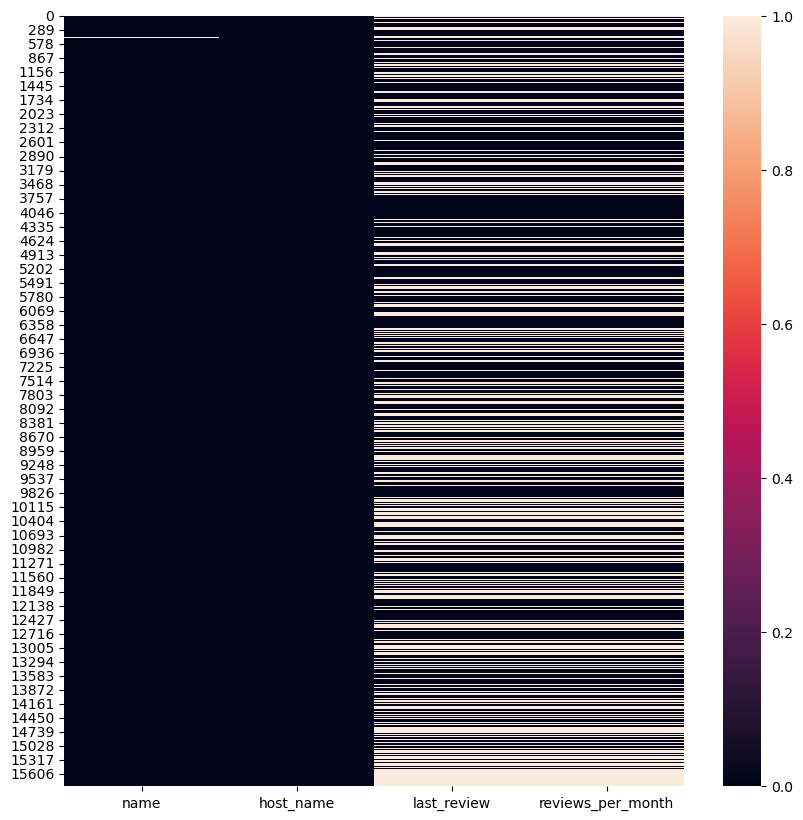

In [6]:
plt.figure(figsize=(10,10))
sns.heatmap(df[['name','host_name','last_review','reviews_per_month']].isna())

## **Insight**
Berdasarkan grafik dan informasi diatas bahwa :

- pada kolom name terdapat missing value pada 1 baris
- pada kolom host_name terdapat missing value pada 8 baris jika di persentase terdapat <0.06% dari data
- sedangkan pada kolom last_review dan reviews_per_month terdapat hubungan pada kedua kolom ini yaitu jika kolom last_review terdapat missing value makan kolom reviews_per_month juga hilang

## **Asumsi**
untuk mengatasi missing value tersebut dapat dilakukan sebagai berikut

- untuk kolom yang memiliki missing value < 0.5% maka akan dilakukan drop pada rows
- untuk kolom yang memiliki missing value > 0.5% maka akan diisi dengan perhitungan dengan perhitungan kolom lain atau akan dilakukan drop pada kolom tersebut

# **Handling missing value**

In [7]:
# drop baris pada kolom name dan host_name
df.dropna(subset=['name','host_name'],inplace=True)

In [8]:
df['reviews_per_month'].fillna(df['number_of_reviews'] / 12, inplace=True)

C:\Users\T470\AppData\Local\Temp\ipykernel_23232\3842916700.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['reviews_per_month'].fillna(df['number_of_reviews'] / 12, inplace=True)


In [9]:
df.drop(columns=['last_review'], inplace=True)

In [10]:
missing_name = df['name'].isnull().sum()
missing_host_name = df['host_name'].isnull().sum()
missing_reviews = df['reviews_per_month'].isnull().sum()

print(f"Missing in 'name': {missing_name}, Missing in 'host_name': {missing_host_name}, Missing in 'reviews_per_month': {missing_reviews}")

Missing in 'name': 0, Missing in 'host_name': 0, Missing in 'reviews_per_month': 0


## **Kesimpulan**

- Melakukan drop rows di kolom name dan host name
- Mengisi nilai kosong (NaN) di kolom reviews_per_month akan diisi dengan rata-rata ulasan per bulan, yang dihitung dari number_of_reviews / 12(jumlah bulan dalam setahun).
- Melakukan drop pada kesuluruhan kolom last_review, Alasan untuk menghapus keseluruhan kolom last_review:
- 1.Analisis Tidak Memerlukan Tanggal: Analisis hanya berfokus pada jumlah ulasan atau kinerja umum listing, tanggal spesifik dari ulasan terakhir mungkin tidak relevan.
- 2.Banyak Data Kosong: Kolom ini memiliki 5790 nilai kosong (sekitar 36.5% dari total data). Jika tidak signifikan untuk analisis, menghapusnya dapat menyederhanakan dataset.
- 3.Informasi tentang jumlah ulasan (seperti reviews_per_month atau number_of_reviews) mungkin cukup tanpa memerlukan tanggal terakhir.

Kemudian setelah melakukan cek kolom **name**,**host_name** dan **reviews_per_month** ke 3 kolom tersebut sudah tidak terdapat missing value dan secara keseluruhan dataset ini, sudah tidak terdapat missing value dan karena penghapusan kolom **last_review** kini dataset telah berkurang jadi 15854 rows dan 16 kolom

## **OUTLIER**

Text(0, 0.5, 'Harga')

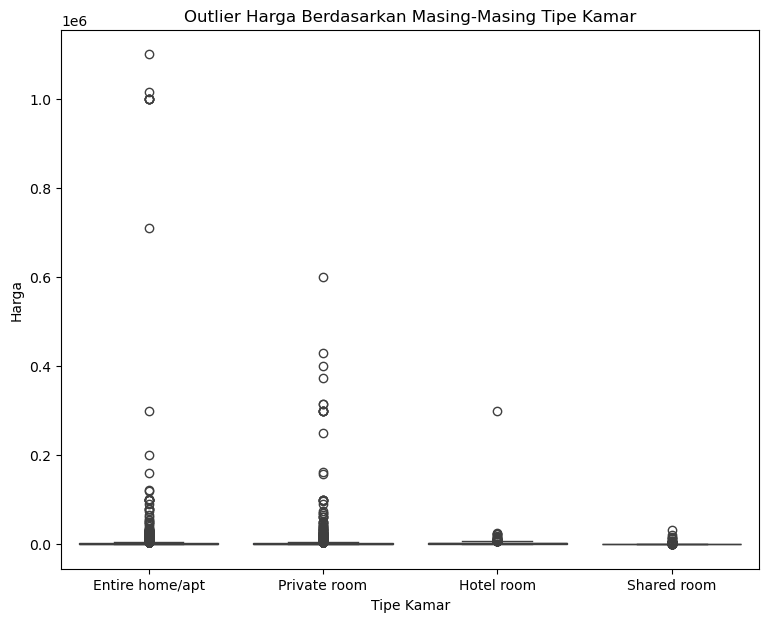

In [11]:
# akan dicek antara tipe kamar dengan harga
plt.figure(figsize=(9,7))
sns.boxplot(x='room_type',y='price',data=df)
plt.title('Outlier Harga Berdasarkan Masing-Masing Tipe Kamar')
plt.xlabel('Tipe Kamar')
plt.ylabel('Harga')

## **Cek harga di setiap tipe kamar**

In [12]:
price_entire_home = df[df['room_type']=='Entire home/apt'][['price']].sort_values(by='price',ascending=False)
display(price_entire_home.head())
display(price_entire_home.tail())

,price
12868,1100000
12300,1014758
6289,1000000
1779,1000000
4620,1000000


,price
11215,348
9657,346
1481,346
5246,337
10222,332


In [13]:
price_private_room = df[df['room_type']=='Private room'][['price']].sort_values(by='price',ascending=False)
display(price_private_room.head())
display(price_private_room.tail())

,price
4373,600700
11885,429443
12792,400717
6549,372227
6760,314899


,price
11663,315
7831,310
8974,304
9529,300
15551,278


In [14]:
price_hotel_room = df[df['room_type']=='Hotel room'][['price']].sort_values(by='price',ascending=False)
display(price_hotel_room.head())
display(price_hotel_room.tail())

,price
2668,300000
3415,24390
6281,23671
6283,23629
6282,23029


,price
8445,326
8983,318
2748,318
2770,318
11103,0


In [15]:
price_hotel_room = df[df['room_type']=='Shared room'][['price']].sort_values(by='price',ascending=False)
display(price_hotel_room.head())
display(price_hotel_room.tail())

,price
7857,31200
6868,20895
2430,17316
5577,13852
5079,13000


,price
9636,303
15473,295
15456,280
15401,280
15455,280


### **Kesimpulan**
Dapat disimpulkan bahwa :

- outlier yang terjadi pada semua tipe kamar bisa saja terjadi karena listing dapat memberikan harga yang tinggi untuk properti yang disewakan.
- terdapat anomali pada harga di tipe kamar hotel room, yaitu terdapat harga 0 dan itu tidak mungkin untuk suatu properti di sewakan dengan harga nol. Maka anomali tersebut akan di drop

In [16]:
# drop kolom tipe hotel room yang memiliki harga 0
df.drop(df[(df['room_type'] == 'hotel room') & (df['price'] == 0)].index, inplace=True)

# **Membuat kolom baru berdasarkan harga**

In [17]:
df['price'].describe()

count    1.584500e+04
mean     3.218580e+03
std      2.497917e+04
min      0.000000e+00
25%      9.000000e+02
50%      1.429000e+03
75%      2.429000e+03
max      1.100000e+06
Name: price, dtype: float64

In [18]:
# Statistik harga
q1 = 9.000000e+02  # Kuartil pertama (25%)
median = 1.429000e+03  # Median (50%)
q3 = 2.429000e+03  # Kuartil ketiga (75%)

# Fungsi untuk mengkategorikan harga
def categorize_price(price):
    if price < q1:
        return "Low class"
    elif q1 <= price < median:
        return "Medium class"
    elif median <= price < q3:
        return "High class"
    else:
        return "Luxury class"

# Terapkan fungsi pada kolom 'price'
df['price_category'] = df['price'].apply(categorize_price)

In [19]:
df.head()

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,price_category
0,0,27934,Nice room with superb city view,120437,Nuttee,Ratchathewi,13.75983,100.54134,Entire home/apt,1905,3,65,0.50,2,353,0,High class
1,1,27979,"Easy going landlord,easy place",120541,Emy,Bang Na,13.66818,100.61674,Private room,1316,1,0,0.00,2,358,0,Medium class
2,2,28745,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,13.75232,100.62402,Private room,800,60,0,0.00,1,365,0,Low class
3,3,35780,Spacious one bedroom at The Kris Condo Bldg. 3,153730,Sirilak,Din Daeng,13.78823,100.57256,Private room,1286,7,2,0.03,1,323,1,Medium class
4,4,941865,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,13.76872,100.63338,Private room,1905,1,0,0.00,3,365,0,High class


In [20]:
df.to_csv('data.csv', index=False)

# **Analisis**

## **Seberapa merata distribusi harga di setiap kategori**

In [21]:
# Hitung jumlah properti per kategori harga
category_distribution = df['price_category'].value_counts(normalize=True) * 100
category_distribution

price_category
Medium class    25.635847
Luxury class    25.048911
High class      24.985800
Low class       24.329441
Name: proportion, dtype: float64

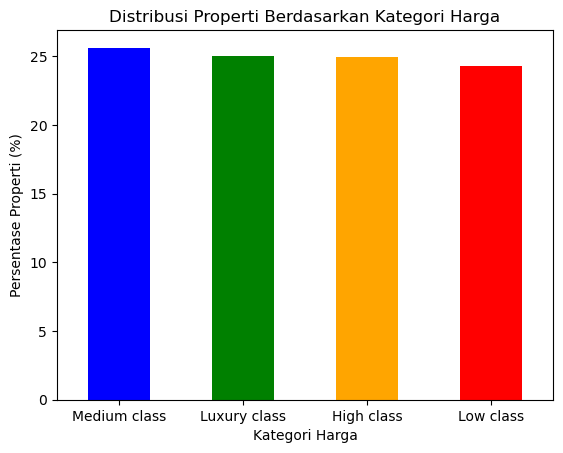

In [22]:
# Visualisasi distribusi harga per kategori
import matplotlib.pyplot as plt

category_distribution.plot(kind='bar', color=['blue', 'green', 'orange', 'red'])
plt.title("Distribusi Properti Berdasarkan Kategori Harga")
plt.xlabel("Kategori Harga")
plt.ylabel("Persentase Properti (%)")
plt.xticks(rotation=0)
plt.show()

### **Insight**

- Medium class memiliki proporsi tertinggi di antara semua kategori harga. Ini menunjukkan bahwa properti dengan harga menengah lebih banyak tersedia atau lebih populer dibandingkan kategori lainnya.
- Luxury class memiliki proporsi yang hampir setara dengan Medium class. Ini menunjukkan adanya permintaan yang cukup besar untuk properti premium di area tersebut, terutama dari penyewa yang mencari pengalaman lebih eksklusif.
- High class memiliki proporsi yang sedikit lebih rendah dibandingkan Medium dan Luxury class. Meskipun demikian, proporsinya cukup signifikan, menunjukkan bahwa properti dengan fasilitas mewah namun tidak se-eksklusif Luxury class tetap diminati.
- Low class memiliki proporsi terendah. Ini mungkin menunjukkan bahwa permintaan untuk properti murah lebih rendah atau bahwa penyedia properti lebih banyak menawarkan properti di kelas menengah hingga mewah.

### **rekomendasi**

- Platform penyewaan dapat melakukan segmentasi yang lebih spesifik sesuai dengan kebutuhan penyewa berdasarkan kategori harga, sehingga dapat memberikan rekomendasi yang lebih tepat.

# **Analisis lingkungan tempat semua kategori harga**

In [30]:
# Filter untuk kategori "Low"
low_price_neighbourhood = df[df['price_category'] == 'Low class']['neighbourhood'].value_counts()
print(low_price_neighbourhood)

neighbourhood
Khlong Toei             277
Huai Khwang             250
Phra Nakhon             244
Phra Khanong            220
Vadhana                 194
Chatu Chak              175
Bang Na                 170
Din Daeng               159
Sathon                  158
Suanluang               151
Ratchathewi             148
Bang Kapi               125
Bang Sue                118
Phaya Thai              110
Bang Rak                107
Bang Phlat              104
Don Mueang               93
Khlong San               81
Pra Wet                  72
Thon buri                70
Lak Si                   69
Phasi Charoen            69
Lat Krabang              68
Bangkok Noi              64
Bang Khen                60
Wang Thong Lang          51
Bang Khae                44
Bang Kho laen            43
Min Buri                 30
Yan na wa                27
Bangkok Yai              26
Parthum Wan              26
Chom Thong               26
Khan Na Yao              25
Dusit                    24
Pom Pr

C:\Users\T470\AppData\Local\Temp\ipykernel_23232\2859039558.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=low_price_neighbourhood.index, y=low_price_neighbourhood.values, palette="coolwarm")


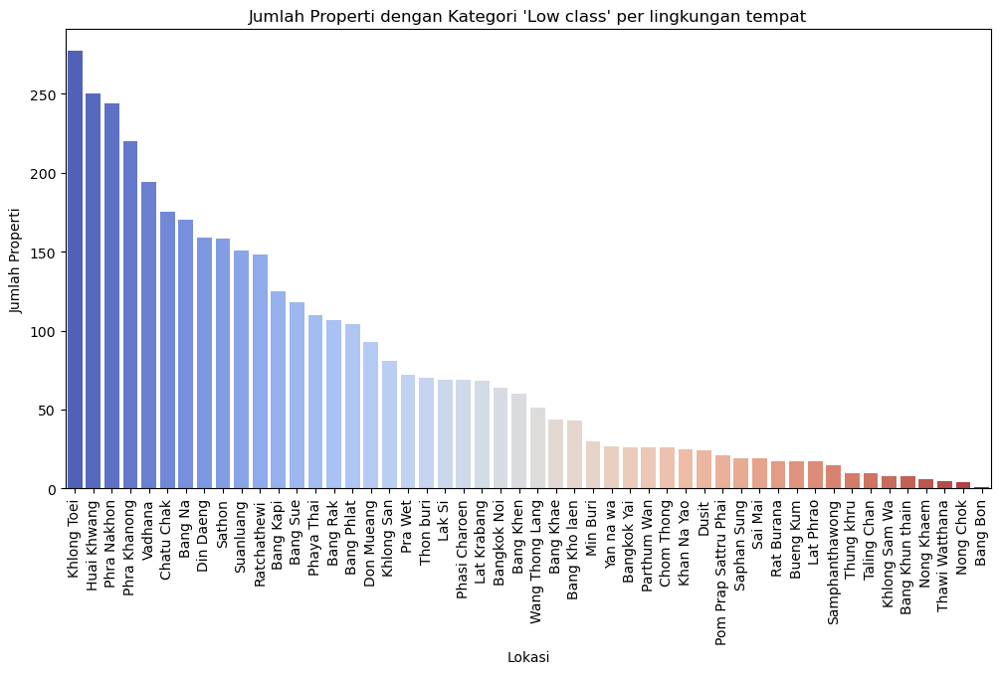

In [31]:
plt.figure(figsize=(12, 6))
sns.barplot(x=low_price_neighbourhood.index, y=low_price_neighbourhood.values, palette="coolwarm")
plt.title("Jumlah Properti dengan Kategori 'Low class' per lingkungan tempat")
plt.xlabel("Lokasi")
plt.ylabel("Jumlah Properti")
plt.xticks(rotation=90)
plt.show()

## **Insight**
- Anda dapat melihat Lokasi mana yang paling banyak menyediakan properti seperti Khlong Toei yang ada 277 properti. Ini menunjukkan area yang lebih terjangkau bagi penyewa dengan anggaran rendah dan sekaligus memberikan rekomendasi kepada penyewa di lingkungan tempat mana yang banyak dengan anggaran rendah di kota bangkok.

In [32]:
# Filter untuk kategori "medium"
medium_price_neighbourhood = df[df['price_category'] == 'Medium class']['neighbourhood'].value_counts()
print(medium_price_neighbourhood)

neighbourhood
Khlong Toei             502
Vadhana                 434
Huai Khwang             368
Sathon                  294
Ratchathewi             254
Bang Rak                202
Phra Khanong            168
Chatu Chak              164
Bang Na                 146
Phra Nakhon             128
Din Daeng               118
Phaya Thai              115
Suanluang               113
Khlong San              107
Parthum Wan              88
Bang Sue                 79
Yan na wa                65
Bang Kapi                56
Thon buri                55
Phasi Charoen            55
Bang Phlat               49
Lat Krabang              41
Pra Wet                  39
Don Mueang               38
Bang Kho laen            37
Bangkok Noi              33
Pom Prap Sattru Phai     32
Lak Si                   31
Dusit                    26
Samphanthawong           21
Bang Khen                21
Chom Thong               20
Bangkok Yai              19
Rat Burana               19
Bang Khae                19
Bueng 

C:\Users\T470\AppData\Local\Temp\ipykernel_23232\759211967.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=medium_price_neighbourhood.index, y=medium_price_neighbourhood.values, palette="coolwarm")


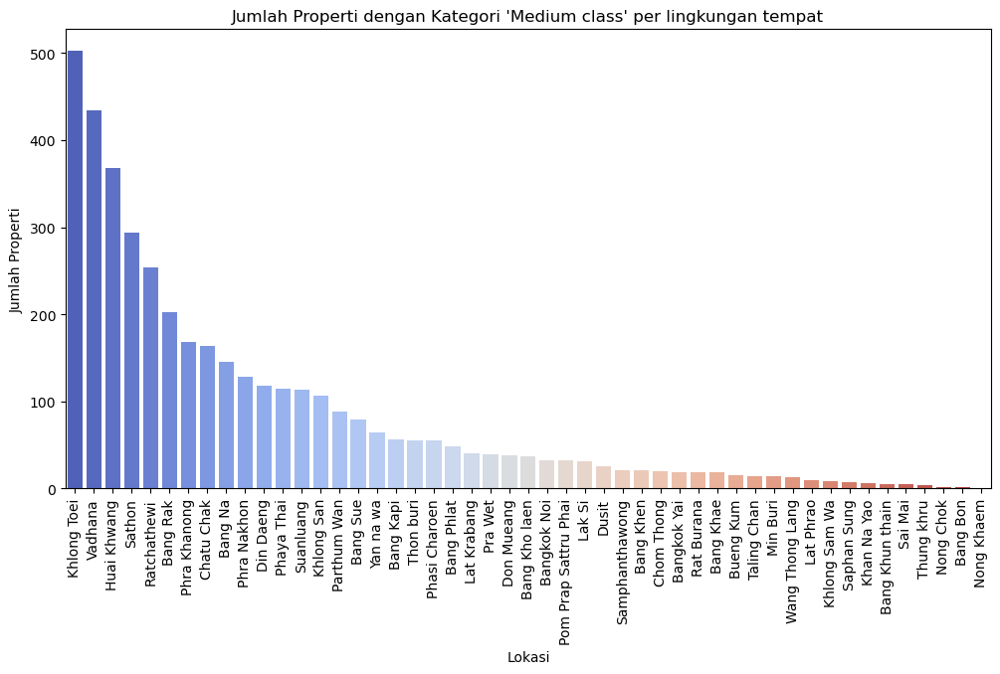

In [33]:
plt.figure(figsize=(12, 6))
sns.barplot(x=medium_price_neighbourhood.index, y=medium_price_neighbourhood.values, palette="coolwarm")
plt.title("Jumlah Properti dengan Kategori 'Medium class' per lingkungan tempat")
plt.xlabel("Lokasi")
plt.ylabel("Jumlah Properti")
plt.xticks(rotation=90)
plt.show()

## **Insight**
- Anda dapat melihat Lokasi mana yang paling banyak menyediakan properti seperti Khlong Toei yang ada 502 properti. Ini menunjukkan area yang lebih terjangkau bagi penyewa dengan budget menyesuaikan dengan rata rata harga listing dan sekaligus memberikan rekomendasi kepada penyewa di lingkungan tempat mana saja listing dengan budget rata rata di kota bangkok.

In [34]:
# Filter untuk kategori "High"
high_price_neighbourhood = df[df['price_category'] == 'High class']['neighbourhood'].value_counts()
print(high_price_neighbourhood)

neighbourhood
Khlong Toei             746
Vadhana                 666
Ratchathewi             403
Huai Khwang             258
Bang Rak                210
Sathon                  201
Chatu Chak              122
Phra Nakhon             118
Parthum Wan             115
Phaya Thai              110
Phra Khanong             99
Din Daeng                89
Khlong San               87
Bang Na                  70
Suanluang                60
Yan na wa                51
Bang Kapi                49
Samphanthawong           36
Bang Sue                 36
Pom Prap Sattru Phai     34
Thon buri                30
Bang Phlat               29
Dusit                    26
Lat Krabang              26
Pra Wet                  25
Bang Kho laen            24
Bangkok Yai              21
Bang Khen                20
Phasi Charoen            19
Don Mueang               18
Chom Thong               18
Bangkok Noi              18
Wang Thong Lang          17
Khan Na Yao              16
Lak Si                   15
Min Bu

C:\Users\T470\AppData\Local\Temp\ipykernel_23232\622051107.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=high_price_neighbourhood.index, y=high_price_neighbourhood.values, palette="coolwarm")


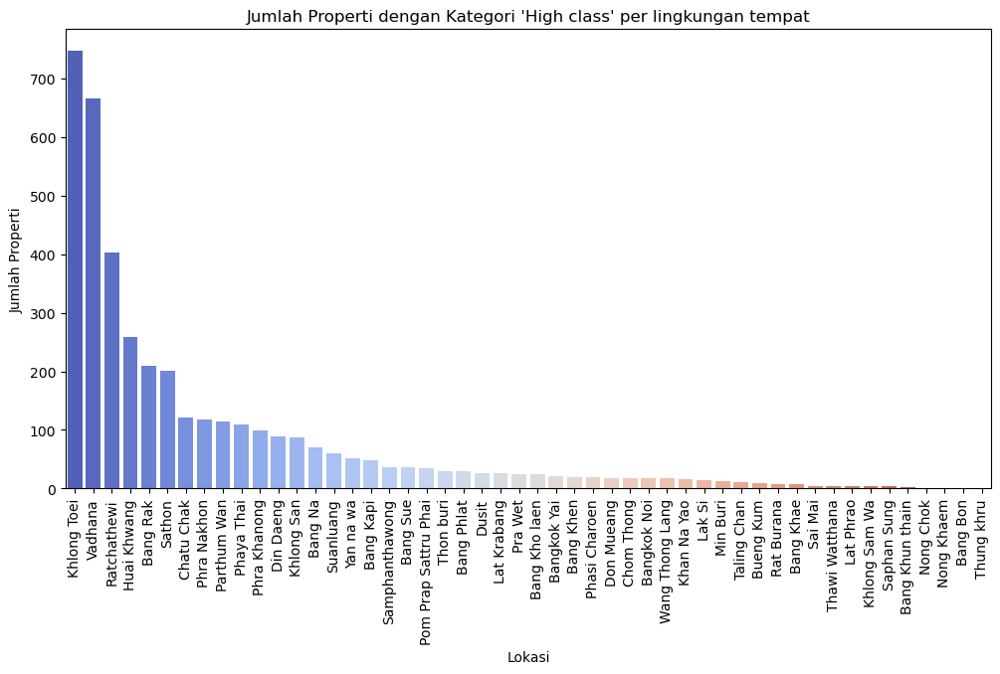

In [35]:
plt.figure(figsize=(12, 6))
sns.barplot(x=high_price_neighbourhood.index, y=high_price_neighbourhood.values, palette="coolwarm")
plt.title("Jumlah Properti dengan Kategori 'High class' per lingkungan tempat")
plt.xlabel("Lokasi")
plt.ylabel("Jumlah Properti")
plt.xticks(rotation=90)
plt.show()

## **Insight**
- Anda dapat melihat Lokasi mana yang paling banyak menyediakan properti, seperti Khlong Toei dengan 746 properti listing. Ini menunjukkan area properti listing dengan harga di atas rata rata bagi penyewa yang mungkin ingin mencari listing dengan fasilitas yang lebih bagus dan sekaligus memberikan rekomendasi kepada penyewa di lingkungan tempat mana saja listing dengan fasilitas lebih bagus di kota bangkok.

In [36]:
# Filter untuk kategori "Luxury"
luxury_price_neighbourhood = df[df['price_category'] == 'Luxury class']['neighbourhood'].value_counts()
print(luxury_price_neighbourhood)

neighbourhood
Vadhana                 857
Khlong Toei             571
Ratchathewi             308
Bang Rak                308
Huai Khwang             249
Parthum Wan             226
Sathon                  156
Phra Nakhon             129
Phaya Thai               87
Chatu Chak               87
Khlong San               82
Din Daeng                77
Bang Na                  71
Phra Khanong             70
Suanluang                58
Yan na wa                57
Samphanthawong           42
Bangkok Noi              37
Bang Kho laen            36
Pom Prap Sattru Phai     36
Bang Phlat               34
Bang Kapi                29
Thon buri                27
Lat Phrao                25
Bangkok Yai              24
Bang Khae                22
Pra Wet                  20
Wang Thong Lang          19
Don Mueang               18
Bang Sue                 17
Taling Chan              15
Saphan Sung              15
Dusit                    15
Bang Khen                15
Lat Krabang              14
Bueng 

C:\Users\T470\AppData\Local\Temp\ipykernel_23232\3469020239.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=luxury_price_neighbourhood.index, y=luxury_price_neighbourhood.values, palette="coolwarm")


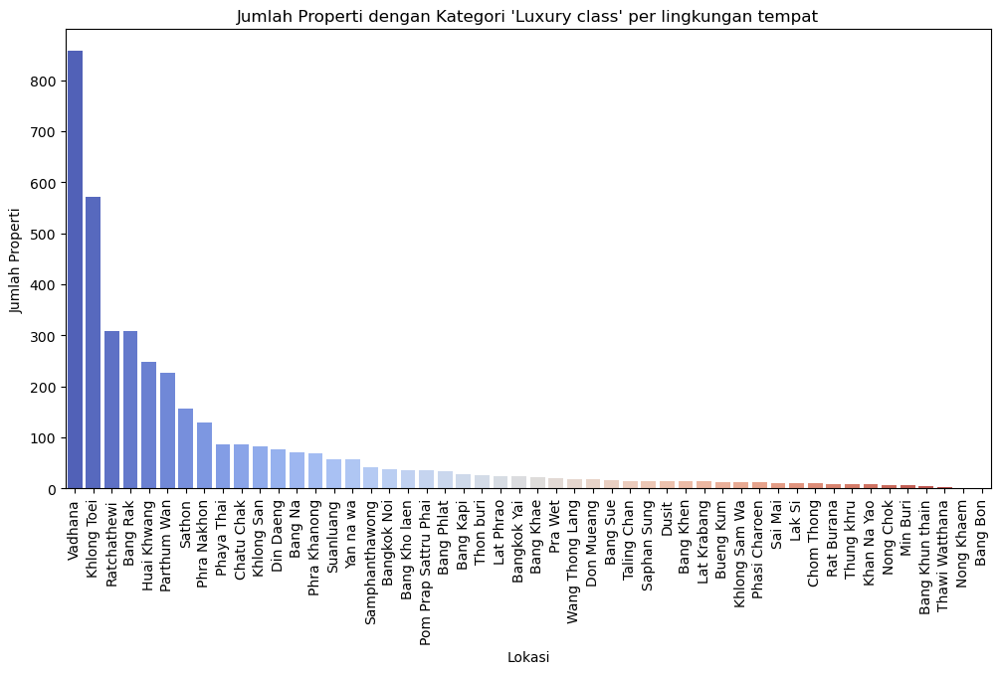

In [37]:
plt.figure(figsize=(12, 6))
sns.barplot(x=luxury_price_neighbourhood.index, y=luxury_price_neighbourhood.values, palette="coolwarm")
plt.title("Jumlah Properti dengan Kategori 'Luxury class' per lingkungan tempat")
plt.xlabel("Lokasi")
plt.ylabel("Jumlah Properti")
plt.xticks(rotation=90)
plt.show()

## **Insight**
- Anda dapat melihat Lokasi mana yang paling banyak menyediakan properti Mewah/Luxury, seperti Vadhana yang ada 857 properti listing mewah dengan harga penyewaan yang bisa terbilang tinggi. listing di luxury class ini mungkin menggunakan sistem penyewaan Confidential Rated (Tarif yang diberikan kepada tamu-tamu tertentu sesuai dengan kesepakatan yang telah disetujui oleh kedua pihak)di kota bangkok.

## **Kesimpulan**

- Khlong Toei adalah pusat beragam kategori properti, menjadikannya pilihan menarik bagi penyewa dengan kebutuhan dan anggaran yang bervariasi.
- Vadhana menjadi lokasi utama untuk properti mewah, cocok untuk penyewa yang mencari kemewahan dan kenyamanan ekstra.

### **Rekomendasi**

- Pemilik properti di daerah ini dapat memanfaatkan popularitas masing-masing kategori dengan menyesuaikan penawaran mereka untuk menjangkau target pasar yang spesifik.

# **Analisis Tipe kamar yang mendominasi di setiap type kategori harga**

In [38]:
low_price_data = df[df['price_category'] == 'Low class']

In [39]:
room_type_distribution_low = low_price_data['room_type'].value_counts(normalize=True) * 100
room_type_distribution_low

room_type
Private room       45.706874
Entire home/apt    39.325551
Shared room        11.413748
Hotel room          3.553826
Name: proportion, dtype: float64

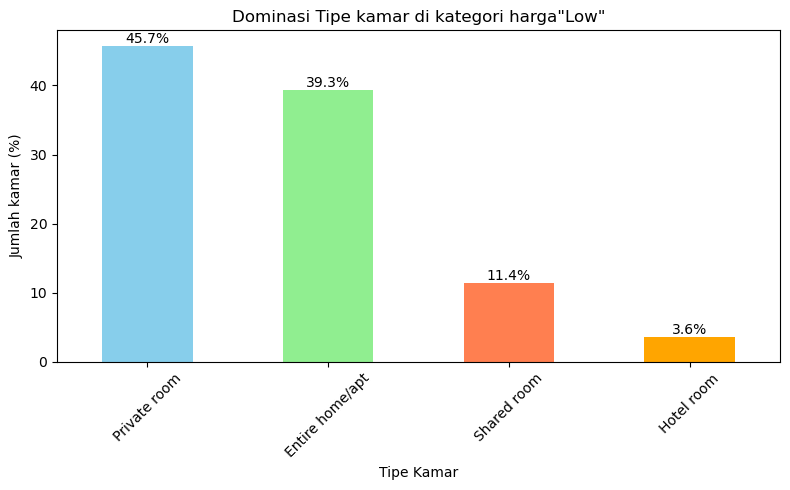

In [40]:
plt.figure(figsize=(8, 5))
ax = room_type_distribution_low.plot(kind='bar', color=['skyblue', 'lightgreen', 'coral', 'orange'])
plt.title('Dominasi Tipe kamar di kategori harga"Low"')
plt.xlabel('Tipe Kamar')
plt.ylabel('Jumlah kamar (%)')
plt.xticks(rotation=45)
plt.tight_layout()

for container in ax.containers:
    # Menggunakan loop untuk setiap bar dalam container
    ax.bar_label(container, fmt='%.1f%%', label_type='edge', fontsize=10)
plt.show()

In [41]:
Medium_price_data = df[df['price_category'] == 'Medium class']

In [42]:
room_type_dominasi_Medium = Medium_price_data['room_type'].value_counts(normalize=True) * 100
room_type_dominasi_Medium

room_type
Entire home/apt    57.927129
Private room       37.764648
Hotel room          3.348104
Shared room         0.960118
Name: proportion, dtype: float64

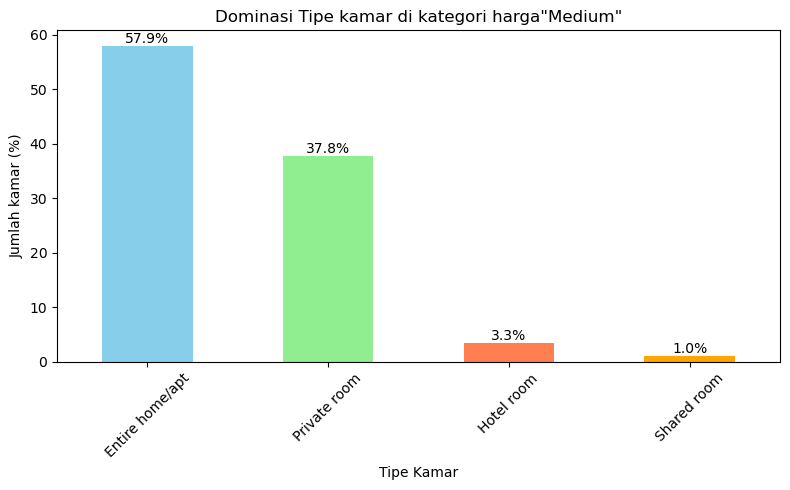

In [43]:
plt.figure(figsize=(8, 5))
ax = room_type_dominasi_Medium.plot(kind='bar', color=['skyblue', 'lightgreen', 'coral', 'orange'])
plt.title('Dominasi Tipe kamar di kategori harga"Medium"')
plt.xlabel('Tipe Kamar')
plt.ylabel('Jumlah kamar (%)')
plt.xticks(rotation=45)
plt.tight_layout()

# Tambahkan persentase di atas bar
for container in ax.containers:
    # Menggunakan loop untuk setiap bar dalam container
    ax.bar_label(container, fmt='%.1f%%', label_type='edge', fontsize=10)
plt.show()

In [44]:
H_price_data = df[df['price_category'] == 'High class']

In [45]:
room_type_dominasi_High = H_price_data['room_type'].value_counts(normalize=True) * 100
room_type_dominasi_High

room_type
Entire home/apt    64.511240
Private room       30.992675
Hotel room          4.041425
Shared room         0.454660
Name: proportion, dtype: float64

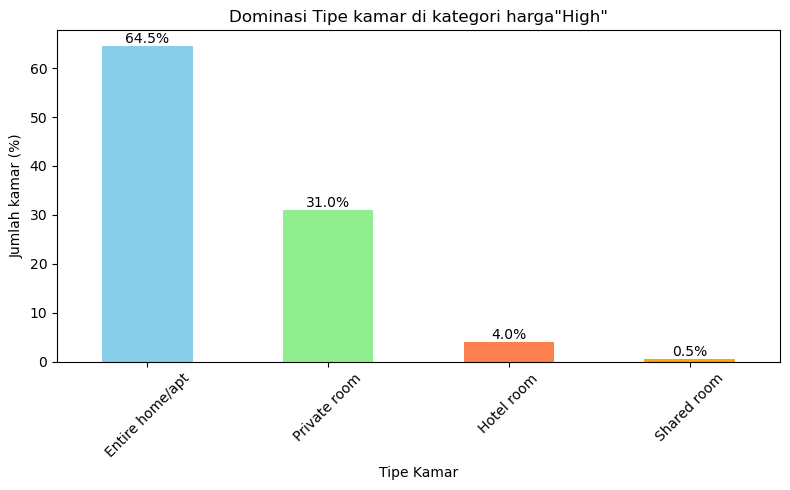

In [46]:
plt.figure(figsize=(8, 5))
ax = room_type_dominasi_High.plot(kind='bar', color=['skyblue', 'lightgreen', 'coral', 'orange'])
plt.title('Dominasi Tipe kamar di kategori harga"High"')
plt.xlabel('Tipe Kamar')
plt.ylabel('Jumlah kamar (%)')
plt.xticks(rotation=45)
plt.tight_layout()

# Tambahkan persentase di atas bar
for container in ax.containers:
    # Menggunakan loop untuk setiap bar dalam container
    ax.bar_label(container, fmt='%.1f%%', label_type='edge', fontsize=10)
plt.show()

In [47]:
L_price_data = df[df['price_category'] == 'Luxury class']

In [48]:
room_type_dominasi_Luxury = L_price_data['room_type'].value_counts(normalize=True) * 100
room_type_dominasi_Luxury

room_type
Entire home/apt    62.685815
Private room       31.216931
Hotel room          5.442177
Shared room         0.655077
Name: proportion, dtype: float64

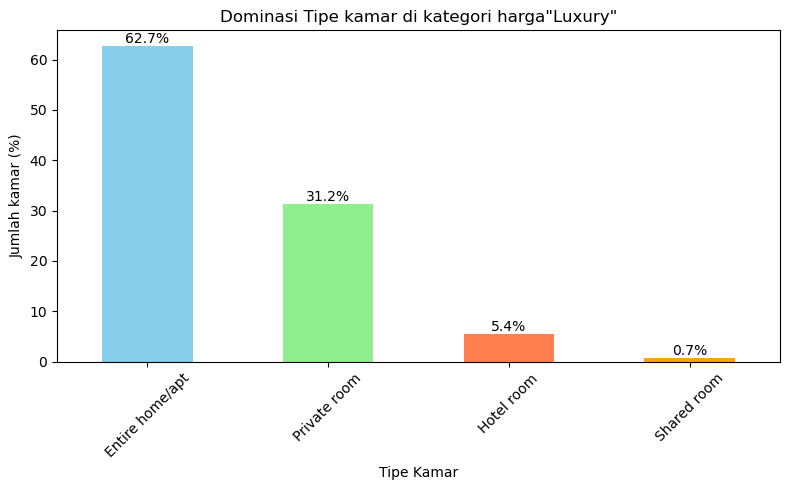

In [49]:
plt.figure(figsize=(8, 5))
ax = room_type_dominasi_Luxury.plot(kind='bar', color=['skyblue', 'lightgreen', 'coral', 'orange'])
plt.title('Dominasi Tipe kamar di kategori harga"Luxury"')
plt.xlabel('Tipe Kamar')
plt.ylabel('Jumlah kamar (%)')
plt.xticks(rotation=45)
plt.tight_layout()

# Tambahkan persentase di atas bar
for container in ax.containers:
    # Menggunakan loop untuk setiap bar dalam container
    ax.bar_label(container, fmt='%.1f%%', label_type='edge', fontsize=10)
plt.show()

## **Insight**

- Private room (45.71%) dan Entire home/apt (39.33%) mendominasi.
- Penyewa dengan anggaran terbatas lebih memilih private room karena biaya lebih rendah, sementara entire home/apt cukup populer untuk mereka yang membutuhkan privasi tambahan.

- Entire home/apt (57.93%) mendominasi dengan Private room (37.76%) sebagai pilihan kedua.
- Penyewa di kategori ini cenderung mencari keseimbangan antara privasi dan harga, sehingga entire home/apt lebih diminati. Hal ini menunjukkan bahwa properti ini cocok untuk keluarga kecil atau kelompok wisatawan.

- Entire home/apt (64.51%) mendominasi, diikuti oleh Private room (30.99%).
- Penyewa di kategori ini menginginkan properti dengan fasilitas lengkap dan privasi tinggi, menjadikannya populer untuk profesional, ekspatriat, atau keluarga dengan anggaran lebih besar.

- Entire home/apt (62.69%) tetap menjadi favorit, dengan Private room (31.22%) sebagai pilihan signifikan, dan Hotel room (5.44%) lebih sering ditemukan di kategori ini dibandingkan kategori lainnya.
- Penyewa kategori ini mencari properti mewah dengan privasi dan fasilitas eksklusif. Popularitas hotel room menunjukkan adanya minat terhadap pengalaman menginap mewah seperti layanan hotel, terutama untuk penyewa jangka pendek dengan preferensi tinggi terhadap layanan.

## **Kesimpulan**

- Dominasi Entire home/apt menunjukkan kebutuhan akan privasi tinggi di seluruh kategori, terutama pada Medium, High, dan Luxury class.

- Private room tetap populer di kategori Low dan Medium, menunjukkan kebutuhan fleksibilitas bagi penyewa dengan anggaran terbatas.

## **Rekomendasi**

- Pemilik properti di kategori low dapat menargetkan pelajar, pekerja lepas, dan wisatawan jangka pendek dengan menawarkan private room yang nyaman dan fleksibel. Selain itu, promosi jangka pendek seperti diskon mingguan dapat meningkatkan daya tarik.
- Pemilik properti di kategori medium dapat menargetkan keluarga atau pekerja profesional yang membutuhkan ruang lebih besar dengan menambahkan fasilitas seperti dapur lengkap atau ruang kerja. Promosi paket keluarga juga bisa menjadi nilai tambah.
- Pemilik properti di kategori high dapat menawarkan fasilitas premium seperti layanan kebersihan mingguan, kolam renang, atau gym untuk menarik penyewa kelas atas. Menyediakan layanan tambahan seperti sewa jangka panjang dengan diskon dapat meningkatkan minat.
- Pemilik properti di kategori luxury/mewah ini dapat mempertimbangkan untuk menawarkan layanan concierge atau fasilitas premium seperti spa dan restoran eksklusif. Penyediaan opsi short-term stay atau paket khusus akhir pekan dapat menarik lebih banyak penyewa dari kalangan kelas atas.

# **Analisis Top 5 Lokasi terpopuler berdasarkan jumlah review**


In [50]:
df1 = df.groupby(['neighbourhood', 'price_category'])['number_of_reviews'].sum().reset_index()
df1.head()

,neighbourhood,price_category,number_of_reviews
0,Bang Bon,High class,0
1,Bang Bon,Low class,0
2,Bang Bon,Luxury class,0
3,Bang Bon,Medium class,1
4,Bang Kapi,High class,354


In [51]:
pivot_reviews = df1.pivot(index='neighbourhood', columns='price_category', values='number_of_reviews')
pivot_reviews.head()

price_category,High class,Low class,Luxury class,Medium class
neighbourhood,,,,
Bang Bon,0.0,0.0,0.0,1.0
Bang Kapi,354.0,1106.0,164.0,191.0
Bang Khae,1.0,142.0,3.0,13.0
Bang Khen,397.0,186.0,75.0,76.0
Bang Kho laen,429.0,1168.0,362.0,659.0


In [52]:
pivot_reviews.isna().sum()

price_category
High class      0
Low class       0
Luxury class    0
Medium class    1
dtype: int64

In [54]:
pivot_reviews.dropna(inplace=True)

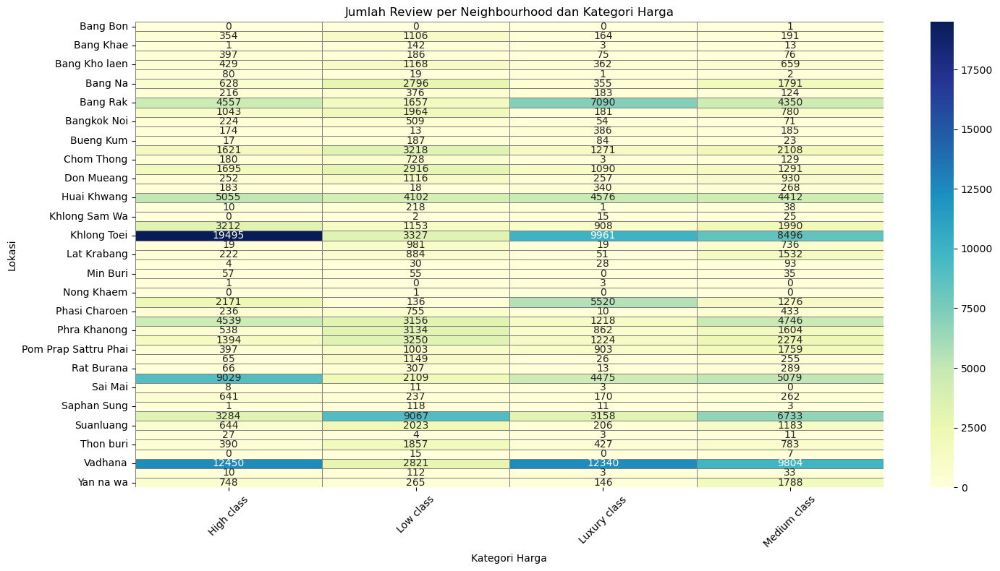

In [55]:
plt.figure(figsize=(15, 8))
sns.heatmap(pivot_reviews, cmap='YlGnBu', annot=True, fmt='.0f', linewidths=0.5, linecolor='gray')
plt.title('Jumlah Review per Neighbourhood dan Kategori Harga')
plt.xlabel('Kategori Harga')
plt.ylabel('Lokasi')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [56]:
top_neighbourhoods = df1.groupby('neighbourhood')['number_of_reviews'].sum().nlargest(5).index
top_reviews = df1[df1['neighbourhood'].isin(top_neighbourhoods)]

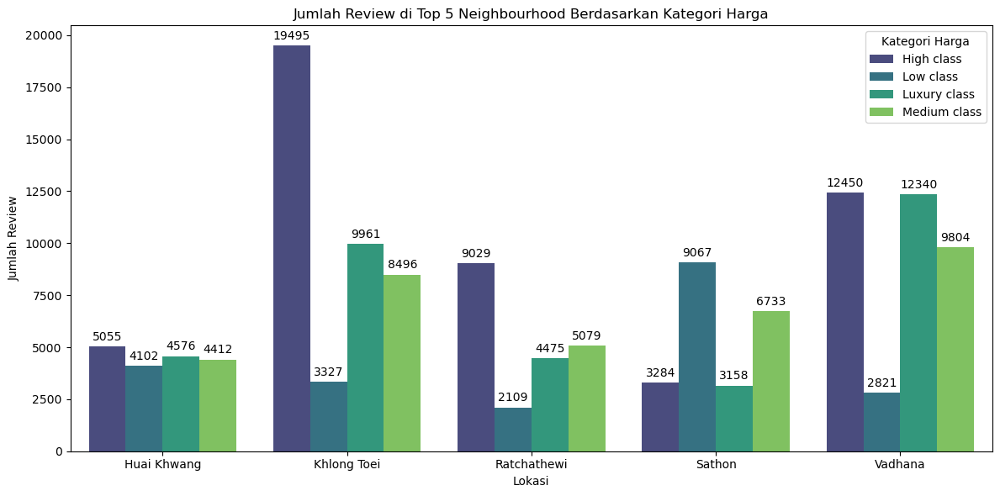

In [57]:
plt.figure(figsize=(12, 6))
sns.barplot(data=top_reviews, x='neighbourhood', y='number_of_reviews', hue='price_category', palette='viridis')

# Menambahkan anotasi jumlah angka di tiap bar
for container in plt.gca().containers:
    plt.gca().bar_label(container, fmt='%d', label_type='edge', fontsize=10, padding=3)

plt.title('Jumlah Review di Top 5 Neighbourhood Berdasarkan Kategori Harga')
plt.xlabel('Lokasi')
plt.ylabel('Jumlah Review')
plt.legend(title='Kategori Harga')
plt.tight_layout()
plt.show()

## **Insight**

- Khlong Toei memimpin dengan jumlah review tertinggi di berbagai kategori, terutama High class (19.495 review). Hal ini menunjukkan popularitas tinggi dan aktivitas penyewaan yang signifikan di wilayah ini.
- Dominasi kategori High class di Khlong Toei menunjukkan bahwa kawasan ini menjadi pilihan favorit untuk properti premium.

- Vadhana mencatat jumlah review yang tinggi di Luxury class (12.340 review), menunjukkan permintaan tinggi akan properti mewah di daerah ini.

- Sathon dan Ratchathewi memiliki distribusi review yang cukup merata di antara kategori Medium, High, dan Luxury class, yang menunjukkan daya tarik beragam untuk berbagai jenis penyewa.

- Jumlah review yang relatif tinggi di Low dan Medium class menunjukkan bahwa Huai Khwang adalah lingkungan yang diminati oleh penyewa dengan anggaran terbatas atau menengah.

## **Kesimpulan**

- Dari Visualisasi di atas ini terlihat visualisasi ini memberikan gambaran bahwa setiap kawasan memiliki daya tarik dan potensi pasar berbeda tergantung pada kategori harga. Strategi pemasaran dan pengelolaan properti yang disesuaikan dengan karakteristik tiap kawasan dapat meningkatkan jumlah penyewaan serta review positif.

## **Rekomendasi**

- Pemilik properti di Khlong Toei dapat memanfaatkan popularitas area ini dengan meningkatkan fasilitas dan layanan, terutama untuk properti High class, seperti menawarkan paket layanan tambahan atau fasilitas premium.
- Mengingat tingginya permintaan akan properti Luxury class di Vadhana, pemilik dapat mempertimbangkan untuk menambah fasilitas eksklusif seperti concierge, spa, atau layanan khusus untuk menarik lebih banyak penyewa kelas atas.
- Karena minat yang merata di berbagai kategori, pemilik properti di Sathon dan Ratchathewi bisa menargetkan berbagai segmen penyewa dengan strategi pemasaran yang disesuaikan untuk masing-masing kategori harga. Misalnya, menyediakan promosi untuk penyewa jangka panjang di Luxury class serta diskon jangka pendek untuk Medium dan High class.
- Pemilik properti di Huai Khwang bisa fokus pada penyewa dengan anggaran terbatas atau menengah dengan menawarkan paket fleksibel seperti sewa mingguan atau bulanan, serta menonjolkan aksesibilitas dan fasilitas dasar yang baik.

# **Analisis top 5 minimum night di semua kategori harga**

In [59]:
top_5_minimum_nights_per_category = (
    df.sort_values('minimum_nights', ascending=False)
      .groupby('price_category')
      .head(5)
      .reset_index(drop=True))

top_5_minimum_nights_per_category

,Unnamed: 0,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,price_category
0,61,1041976,Long-stay special rate spacious entire floor Siam,5735895,Pariya,Parthum Wan,13.74814,100.52016,Entire home/apt,2900,1125,295,2.61,3,0,0,Luxury class
1,7986,35165443,Wonderful apartment for you holiday in Thai,86991723,Yang,Bang Na,13.67260,100.60352,Entire home/apt,2000,1115,0,0.00,2,358,0,High class
2,11524,49032568,Freehold Condo near Bangsue Grand Station,4661237,Chayanid,Bang Sue,13.80697,100.52362,Entire home/apt,554,1095,0,0.00,1,358,0,Low class
3,10153,41623113,blossom condo舒适双床房摩天轮夜市周边免费泳池健身房@Sathon surasakBTS,162537040,Songnya,Sathon,13.71195,100.52055,Entire home/apt,650,1000,2,0.06,13,179,0,Low class
4,10644,42685153,The Prime Sukhumvit 11 - Room 29/150,337709866,Vatiaz,Vadhana,13.74426,100.55758,Private room,15143,999,0,0.00,1,89,0,Luxury class
5,11243,45051929,Bellevue Boutique Bangkok | Airport Link HUA-MAK,165329146,Sataporn,Suanluang,13.73633,100.63836,Private room,1314,999,0,0.00,2,181,0,Medium class
6,1200,8801560,"30th floor, 10 min to BTS, Seaview",4517723,Kannicha,Bang Na,13.66417,100.64955,Entire home/apt,35000,998,20,0.26,7,365,5,Luxury class
7,1592,10709131,"34Fl 2, M Ladprao Condo,MRT & Malls",32398198,Touchapon,Chatu Chak,13.81699,100.56292,Entire home/apt,760,700,61,0.73,2,364,0,Low class
8,4194,22059876,C,160989331,Annchalee,Thon buri,13.71693,100.48330,Private room,161516,500,3,0.05,1,0,0,Luxury class
9,3694,19893829,2 Bedroom Suite@Kirthana Residence,64131143,Chetna,Vadhana,13.73917,100.56616,Entire home/apt,7286,500,0,0.00,3,48,0,Luxury class


C:\Users\T470\AppData\Roaming\Python\Python312\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 33298 (\N{CJK UNIFIED IDEOGRAPH-8212}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\T470\AppData\Roaming\Python\Python312\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 36866 (\N{CJK UNIFIED IDEOGRAPH-9002}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\T470\AppData\Roaming\Python\Python312\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 21452 (\N{CJK UNIFIED IDEOGRAPH-53CC}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\T470\AppData\Roaming\Python\Python312\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 24202 (\N{CJK UNIFIED IDEOGRAPH-5E8A}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\T470\AppData\Roaming\Python\Python312\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 25151 (\

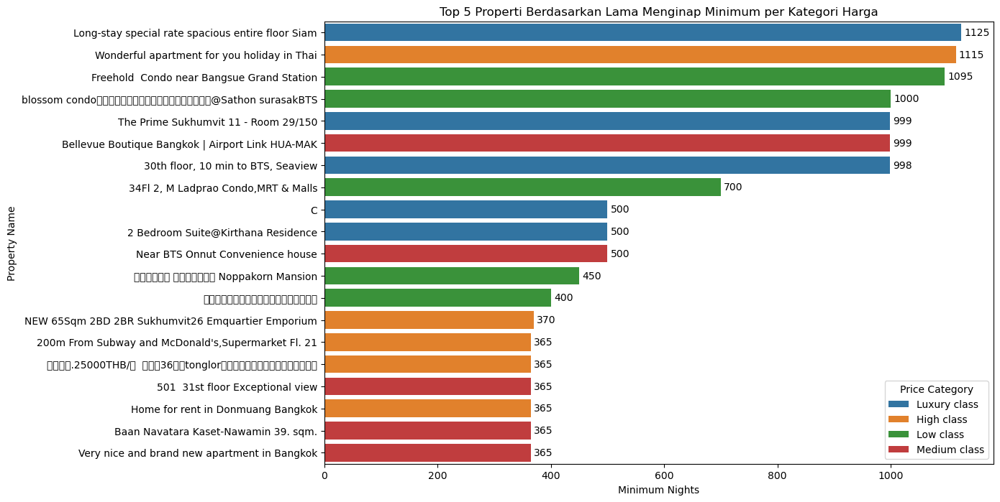

In [60]:
plt.figure(figsize=(12, 8))
sns.barplot(
    data=top_5_minimum_nights_per_category,
    x='minimum_nights',
    y='name',
    hue='price_category',
    dodge=False
)

for container in plt.gca().containers:
    plt.gca().bar_label(container, fmt='%d', label_type='edge', fontsize=10, padding=3)
    
plt.xlabel("Minimum Nights")
plt.ylabel("Property Name")
plt.title("Top 5 Properti Berdasarkan Lama Menginap Minimum per Kategori Harga")
plt.legend(title="Price Category")
plt.show()

## **Insight**

- Properti minimum nights yang sangat tinggi (1125 malam). Ini menunjukkan bahwa properti ini lebih ditargetkan untuk penyewa jangka panjang, mungkin expatriat atau penyewa yang mencari kontrak tahunan.

- Properti dari kategori Luxury dan High Class cenderung memiliki minimum nights yang sangat tinggi (700 hingga 1125 malam).
- Medium Class dan Low Class lebih fleksibel, meskipun ada beberapa properti di kategori ini yang juga memiliki batasan minimum menginap tinggi (sekitar 365 malam).


## **Kesimpulan**

- Properti dengan lama menginap minimum tinggi (700 hingga 1125 malam) terutama ditemukan di kategori Luxury dan High Class. Ini menunjukkan bahwa properti ini menargetkan penyewa jangka panjang.

- Properti di kategori Medium dan Low Class cenderung memiliki fleksibilitas lebih tinggi dalam hal lama menginap minimum. Hal ini memberikan pilihan yang lebih luas bagi penyewa jangka pendek.

## **Rekomendasi**

- Properti yang memiliki minimum stay di atas 365 malam sebaiknya dipromosikan dengan strategi penyewaan jangka panjang, misalnya paket penyewaan tahunan dengan harga diskon atau paket corporate housing (layanan akomodasi yang ditawarkan kepada karyawan perusahaan untuk jangka waktu tertentu).
- Disarankan agar host dengan batas minimum menginap sangat tinggi mempertimbangkan menurunkan persyaratan tersebut untuk meningkatkan peluang penyewaan jangka pendek, terutama untuk kategori Medium dan Luxury.
- Pemilik properti dapat mengevaluasi apakah jumlah minimum stay mereka bersaing dengan properti lain di lingkungan yang sama untuk memastikan mereka tidak kehilangan penyewa potensial.

# **Analisis Titik data properti berdasarkan kategori harga, serta menambahkan titik pusat kota untuk memperjelas area pusat dan pinggiran**


In [61]:
city_center_latitude = df['latitude'].mean()
city_center_longitude = df['longitude'].mean()

print("Titik Pusat Kota:")
print(f"Latitude: {city_center_latitude}")
print(f"Longitude: {city_center_longitude}")

Titik Pusat Kota:
Latitude: 13.7451476455159
Longitude: 100.55989456504929


## **Titik pusat kota bangkok adalah 13°45′00.00″N, 100°31′01.20″E yang kalo dikonversi ke desimal:**
- Latitude:
13°45′00.00″N
= 13 + (45/60) + (0/3600)
= 13.7500°

- Longitude:
100°31′01.20″E
= 100 + (31/60) + (1.20/3600)
= 100.5170°

Tapi karena hitungan rata rata titik pusat kota di data airbnb Listing bangkok tidak terlalu berbeda signifikan Maka saya akan menggunakan hitungan rata rata ini sebagai pusat kota.
- Latitude: 13.7451476455159
- Longitude: 100.55989456504929

In [62]:
import folium
from folium.plugins import MarkerCluster

# Menentukan titik pusat kota 
pusat_kota = [city_center_latitude, city_center_longitude]  # Latitude dan Longitude Bangkok

# Membuat peta dasar
m = folium.Map(location=pusat_kota, zoom_start=12)

# Warna untuk masing-masing kategori harga
color_map = {
    'Low class': 'yellow',
    'Medium class': 'green',
    'High class': 'blue',
    'Luxury class': 'red'
}

# Menambahkan marker cluster
marker_cluster = MarkerCluster().add_to(m)

# Iterasi melalui setiap baris dalam DataFrame
for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=5,
        color=color_map[row['price_category']],
        fill=True,
        fill_color=color_map[row['price_category']],
        fill_opacity=0.6,
        popup=f"Price Category: {row['price_category']}<br>Price: {row['price']}",
    ).add_to(marker_cluster)

# Menampilkan peta
m

In [63]:
Low_data = df[df['price_category'] == 'Low class']

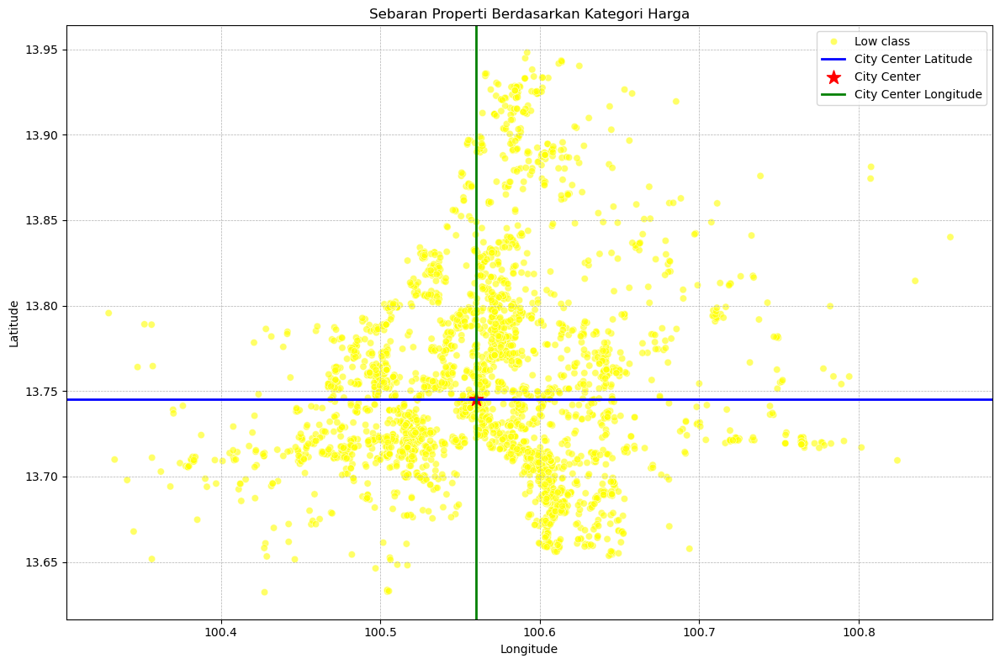

In [64]:
plt.figure(figsize=(12, 8))

# Plot Luxury
sns.scatterplot(data=Low_data, x='longitude', y='latitude', hue='price_category', palette=['yellow'], alpha=0.6)

# Tambahkan Garis Kota (City Center)
city_center_latitude = 13.7451476455159
city_center_longitude = 100.55989456504929

# Garis horizontal untuk latitude
plt.axhline(city_center_latitude, color='blue', linestyle='-', linewidth=2, label='City Center Latitude')
plt.scatter(city_center_longitude, city_center_latitude, color='red', s=150, marker='*', label='City Center')

# Garis vertikal untuk longitude
plt.axvline(city_center_longitude, color='green', linestyle='-', linewidth=2, label='City Center Longitude')


# Menambahkan informasi tambahan
plt.grid(True, linestyle='--', linewidth=0.5)
plt.title('Sebaran Properti Berdasarkan Kategori Harga')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend()
plt.tight_layout()
plt.show()

In [65]:
Medium_data = df[df['price_category'] == 'Medium class']

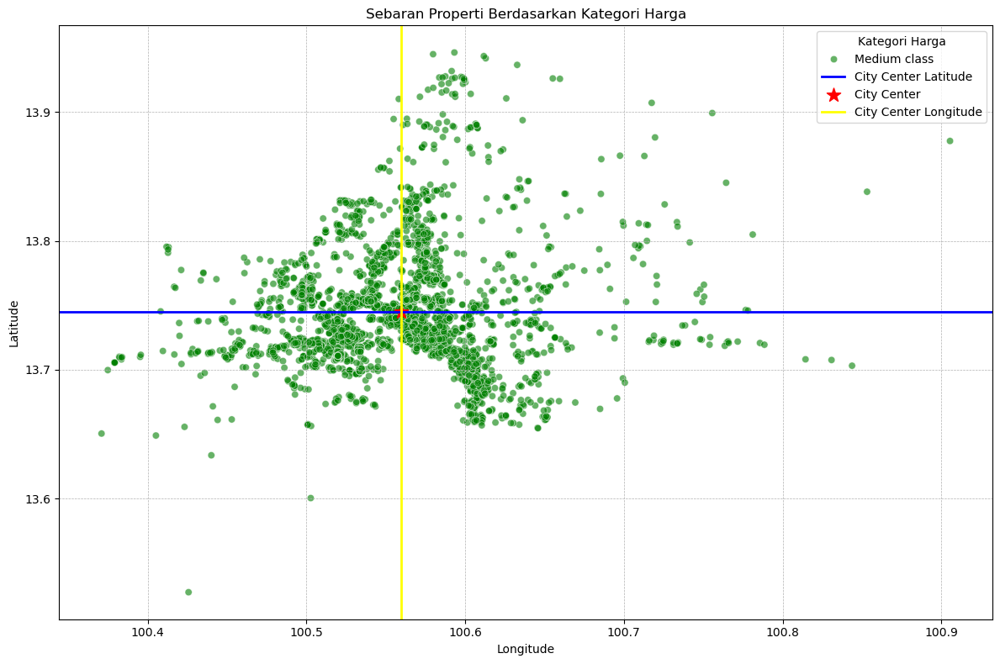

In [66]:
plt.figure(figsize=(12, 8))

# Plot Luxury
sns.scatterplot(data=Medium_data, x='longitude', y='latitude', hue='price_category', palette=['green'], alpha=0.6)

# Tambahkan Garis Kota (City Center)
city_center_latitude = 13.7451476455159
city_center_longitude = 100.55989456504929

# Garis horizontal untuk latitude
plt.axhline(city_center_latitude, color='blue', linestyle='-', linewidth=2, label='City Center Latitude')
plt.scatter(city_center_longitude, city_center_latitude, color='red', s=150, marker='*', label='City Center')

# Garis vertikal untuk longitude
plt.axvline(city_center_longitude, color='yellow', linestyle='-', linewidth=2, label='City Center Longitude')



# Menambahkan informasi tambahan
plt.grid(True, linestyle='--', linewidth=0.5)
plt.title('Sebaran Properti Berdasarkan Kategori Harga')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(title='Kategori Harga')
plt.tight_layout()
plt.show()

In [67]:
High_data = df[df['price_category'] == 'High class']

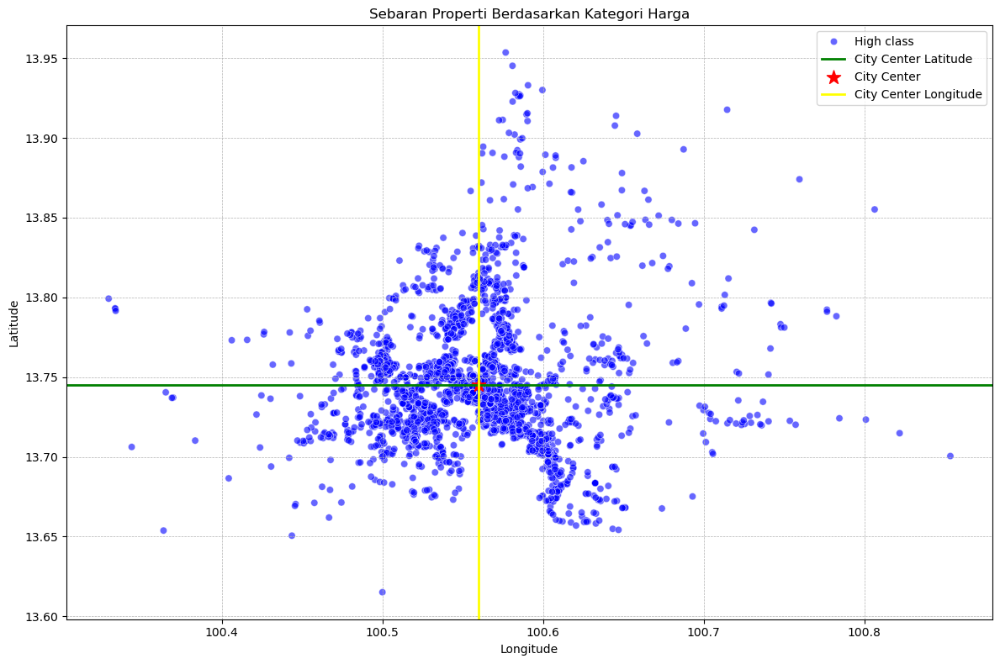

In [68]:
plt.figure(figsize=(12, 8))

# Plot Luxury
sns.scatterplot(data=High_data, x='longitude', y='latitude', hue='price_category', palette=['blue'], alpha=0.6)

# Tambahkan Garis Kota (City Center)
city_center_latitude = 13.7451476455159
city_center_longitude = 100.55989456504929

# Garis horizontal untuk latitude
plt.axhline(city_center_latitude, color='green', linestyle='-', linewidth=2, label='City Center Latitude')
plt.scatter(city_center_longitude, city_center_latitude, color='red', s=150, marker='*', label='City Center')

# Garis vertikal untuk longitude
plt.axvline(city_center_longitude, color='yellow', linestyle='-', linewidth=2, label='City Center Longitude')


# Menambahkan informasi tambahan
plt.grid(True, linestyle='--', linewidth=0.5)
plt.title('Sebaran Properti Berdasarkan Kategori Harga')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend()
plt.tight_layout()
plt.show()

In [69]:
luxury_data = df[df['price_category'] == 'Luxury class']

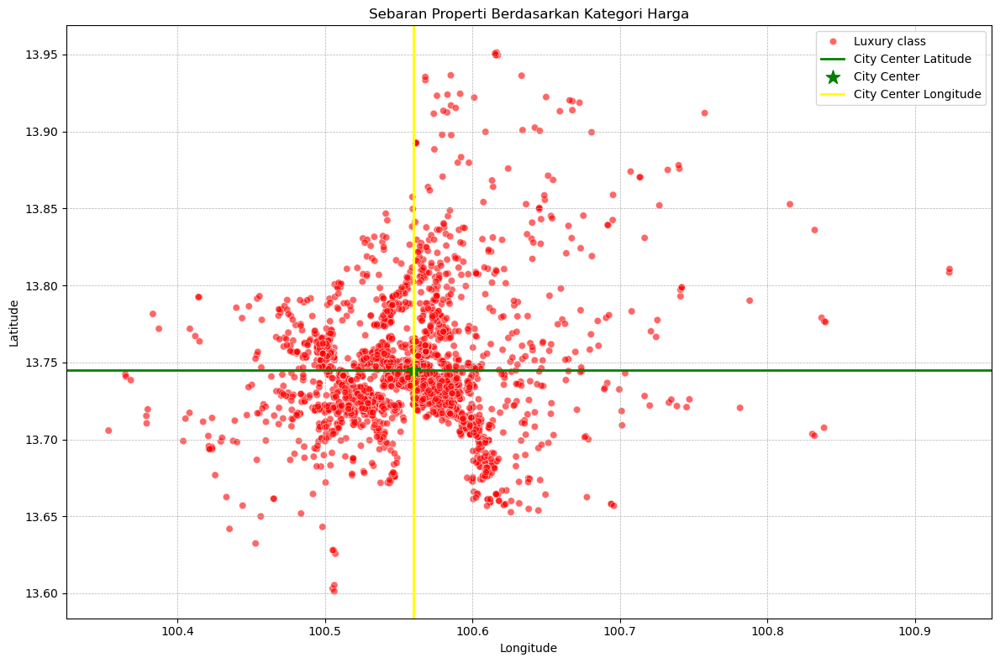

In [70]:
plt.figure(figsize=(12, 8))

# Plot scatter Luxury class
sns.scatterplot(data=luxury_data, x='longitude', y='latitude', hue='price_category', palette=['red'], alpha=0.6)

# Tambahkan Garis Kota (City Center)
city_center_latitude = 13.7451476455159
city_center_longitude = 100.55989456504929

# Garis horizontal untuk latitude
plt.axhline(city_center_latitude, color='green', linestyle='-', linewidth=2, label='City Center Latitude')
plt.scatter(city_center_longitude, city_center_latitude, color='green', s=150, marker='*', label='City Center')

# Garis vertikal untuk longitude
plt.axvline(city_center_longitude, color='yellow', linestyle='-', linewidth=2, label='City Center Longitude')

# Menambahkan informasi tambahan
plt.grid(True, linestyle='--', linewidth=0.5)
plt.title('Sebaran Properti Berdasarkan Kategori Harga')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend()
plt.tight_layout()
plt.show()

## **Insight**

- Sebagian besar properti dengan kategori harga Low terdistribusi lebih jauh dari pusat kota, terutama di wilayah bawah dan kanan bawah peta.

-  Sebagian besar properti kategori "Medium class" terkonsentrasi di sekitar pusat kota, tetapi ada distribusi yang lebih luas dibandingkan properti "Luxury" atau "High class." Ini menunjukkan bahwa properti medium class lebih fleksibel dalam penempatan geografis.
- Banyak properti medium class berada di sekitar pusat kota, yang mencerminkan daya tarik pusat kota untuk pembeli dengan anggaran menengah. Namun, terdapat beberapa properti di pinggiran, memberikan alternatif bagi pembeli yang mencari area dengan harga lebih terjangkau.

- Sebagian besar properti kategori "High class" terkonsentrasi di sekitar pusat kota, mencerminkan daya tarik utama dari pusat kota untuk properti mewah. Area ini biasanya menawarkan fasilitas premium seperti pusat bisnis, restoran kelas atas, dan akses transportasi.
- Beberapa properti "High class" terletak jauh dari pusat kota. Properti ini mungkin menawarkan lingkungan yang lebih privat, pemandangan alam, atau fasilitas unik yang menarik segmen pasar tertentu.

- Sebagian besar properti berada di sekitar area pusat kota. Ini menunjukkan bahwa properti luxury class cenderung terkonsentrasi dekat dengan pusat kota, kemungkinan karena akses yang lebih baik ke fasilitas seperti transportasi, pusat perbelanjaan, dan layanan lainnya.

## **kesimpulan**

- Properti kategori High Class terkonsentrasi di area pusat kota, menunjukkan bahwa penyewa dengan anggaran tinggi cenderung mencari lokasi yang dekat dengan pusat bisnis, hiburan, dan transportasi umum.

- Properti kategori Luxury class cenderung terkonsentrasi di pusat kota karena akses yang lebih baik ke fasilitas utama seperti transportasi, pusat perbelanjaan, dan layanan publik. Ini menciptakan daya tarik bagi penyewa atau pembeli yang mengutamakan kenyamanan dan aksesibilitas.

- Properti kategori Medium Class menunjukkan fleksibilitas yang lebih tinggi dalam distribusi geografis dibandingkan dengan properti Luxury atau High Class. Hal ini memberikan keuntungan bagi pengembang untuk menjangkau segmen pasar yang lebih luas, baik di pusat kota maupun di pinggiran.

- Sebagian besar properti dengan kategori Low class tersebar lebih jauh dari pusat kota, menunjukkan bahwa properti dengan harga terjangkau lebih sering ditemukan di area pinggiran.

## **Rekomendasi**

- Properti di sekitar pusat kota dapat ditargetkan untuk pasar kelas menengah ke atas, sedangkan properti yang jauh dapat diarahkan untuk pasar dengan preferensi biaya rendah.

- Lakukan analisis mendalam untuk memahami preferensi pembeli di setiap lokasi. Properti medium class cenderung memiliki pasar yang beragam, mulai dari profesional muda hingga keluarga. Optimalkan desain dan fasilitas berdasarkan segmen target masing-masing lokasi.

- Properti dekat pusat kota dapat ditargetkan untuk pembeli kelas atas yang mengutamakan aksesibilitas dan kenyamanan, sedangkan properti di luar kota untuk pembeli yang mencari gaya hidup eksklusif dan privasi.

- Promosikan properti di dekat pusat kota sebagai opsi dengan lokasi premium. - Untuk properti di luar pusat kota, strategi pemasaran bisa difokuskan pada pengalaman yang berbeda misalnya, properti resor untuk wisata atau properti ramah lingkungan.

link Tableu = https://public.tableau.com/app/profile/gilang.muhammad.akbar/viz/JCDS-0508capstoneGilangMakbar/Dashboard3?publish=yes
